# 1. Import Packages

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
plt.style.use('seaborn-white')
import datetime
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

# 2. Detailed Data Analysis

In [3]:
df = pd.read_csv("AB_NYC_2019.csv")
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [4]:
# dateset quick overview - shape, null, Dtype
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [5]:
print('Number of features: {}'.format(df.shape[1]))
print('Number of entries: {}'.format(df.shape[0]))

Number of features: 16
Number of entries: 48895


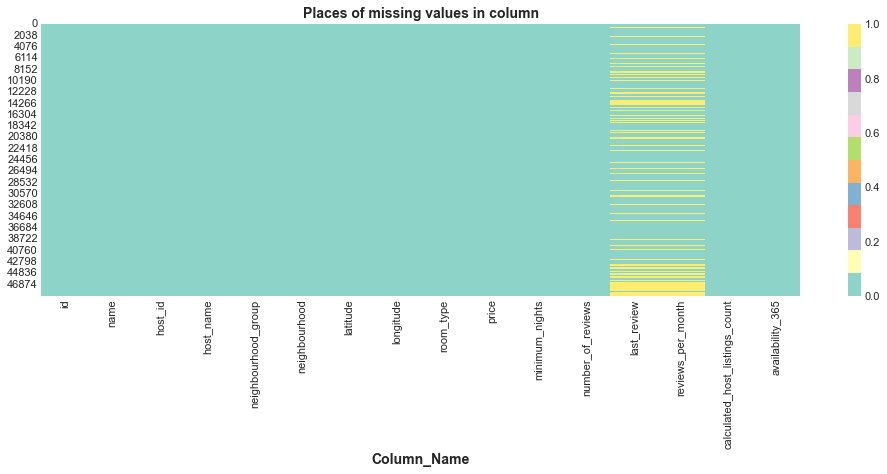

In [6]:
# visualize null values
plt.figure(figsize=(17, 5))
sns.heatmap(df.isnull(), cbar=True, cmap='Set3')
plt.xlabel("Column_Name", size=14, weight="bold")
plt.title("Places of missing values in column",fontweight="bold",size=14)
plt.show()

In [7]:
# percentage of missing values in each column
vars_with_na=[var for var in df.columns if df[var].isnull().sum()>1]

#print the variable name and the percentage of missing values 
for var in vars_with_na:
    print(var,np.round(df[var].isnull().mean(),3),'% missing values')

name 0.0 % missing values
host_name 0.0 % missing values
last_review 0.206 % missing values
reviews_per_month 0.206 % missing values


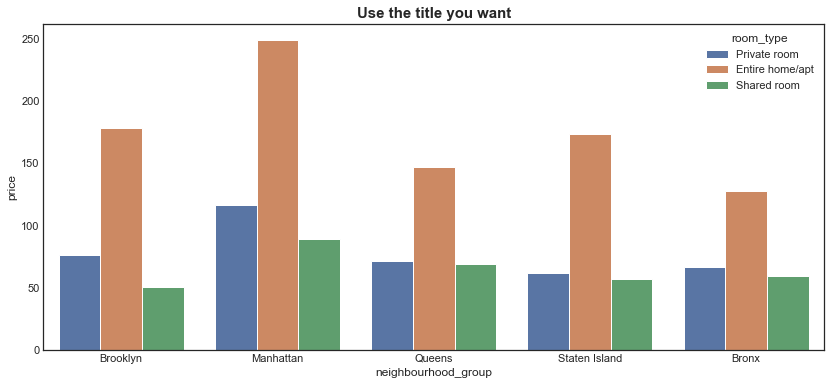

In [8]:
# barplot that shows relation between 3 values
plt.figure(figsize=(14, 6))
sns.barplot(df.neighbourhood_group, df.price, hue=df.room_type, ci=None)
plt.title("Use the title you want", weight="bold", fontsize=15)
plt.show()

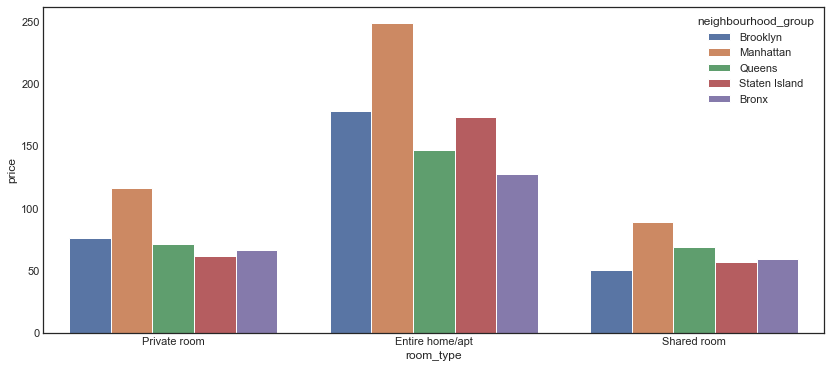

In [9]:
plt.figure(figsize=(14, 6))
sns.barplot(df.room_type, df.price, hue=df.neighbourhood_group, ci=None)
plt.show()

In [10]:
# show feature data distribution
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


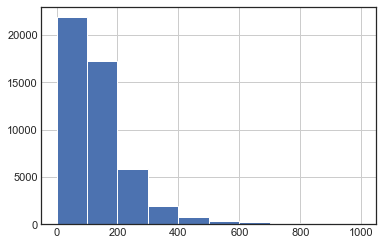

In [11]:
# histogram for a specific feature
hist_price1=df["price"][df["price"]<1000].hist()

In [12]:
# show last 5 rowes
df.tail()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2
48894,36487245,Trendy duplex in the very heart of Hell's Kitchen,68119814,Christophe,Manhattan,Hell's Kitchen,40.76404,-73.98933,Private room,90,7,0,NaN,NaN,1,23


In [13]:
# random sample from data
df.sample(10)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
38131,30094688,Luxurious Brooklyn Office,225943653,Oswin,Brooklyn,Bedford-Stuyvesant,40.68515,-73.94743,Entire home/apt,151,1,1,2018-11-28,0.13,1,179
35603,28272634,Private 2 room apartment in the East village,8554637,Rory,Manhattan,East Village,40.72445,-73.97683,Private room,149,3,36,2019-06-23,3.94,1,109
6515,4727912,"Cosy 2 bed, Gramercy, NYC Apartment",24415699,Charlie,Manhattan,Civic Center,40.71395,-74.00545,Entire home/apt,199,6,0,NaN,NaN,1,0
38176,30124398,"Beautiful 1865 Townhouse, 5 bedrm, Fireplace S...",4077993,Raquel,Brooklyn,Crown Heights,40.67536,-73.94237,Entire home/apt,460,2,2,2019-01-02,0.27,2,0
19919,15963664,Bedroom (#2) in beautiful apt near Central Park,21679450,Vicky,Manhattan,Harlem,40.80251,-73.95765,Private room,50,2,0,NaN,NaN,2,0
1374,607735,Brownstone Home - BEST BKLYN BLOCK!,3011547,Wendy,Brooklyn,Gowanus,40.68466,-73.98871,Entire home/apt,300,30,63,2019-04-18,0.77,3,365
10743,8269241,Room #5 Near Manhattan NYC.,22384027,Shahana,Brooklyn,Crown Heights,40.67073,-73.91799,Private room,39,1,62,2018-11-25,1.34,10,159
47038,35569130,Spacious Room_2,265057419,Dameon,Brooklyn,East New York,40.67072,-73.86947,Private room,68,3,0,NaN,NaN,2,363
5175,3738529,True Industrial Loft in Brooklyn,19111611,Chaim,Brooklyn,Navy Yard,40.69817,-73.96540,Entire home/apt,150,1,7,2016-07-11,0.12,1,0
43508,33689844,Cozy and sunny 2 bedroom apartment,17844480,Angie,Manhattan,Upper West Side,40.80009,-73.96218,Entire home/apt,130,14,0,NaN,NaN,1,2


In [14]:
# show columns
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

In [15]:
# rename columns
df.rename(columns={'neighbourhood_group': 'city'}, inplace=True)
df

,id,name,host_id,host_name,city,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


In [16]:
# check rows and columns
df.shape

(48895, 16)

In [17]:
# check null for every feature
df.isna().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
city                                  0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [18]:
# drop unnecessary columns
df.drop(['id', 'name', 'host_name', 'host_id', 'neighbourhood','number_of_reviews','reviews_per_month','last_review','calculated_host_listings_count'], axis=1, inplace=True )
df.head()

,city,latitude,longitude,room_type,price,minimum_nights,availability_365
0,Brooklyn,40.64749,-73.97237,Private room,149,1,365
1,Manhattan,40.75362,-73.98377,Entire home/apt,225,1,355
2,Manhattan,40.80902,-73.94190,Private room,150,3,365
3,Brooklyn,40.68514,-73.95976,Entire home/apt,89,1,194
4,Manhattan,40.79851,-73.94399,Entire home/apt,80,10,0


In [19]:
# check null again
df.isna().sum()

city                0
latitude            0
longitude           0
room_type           0
price               0
minimum_nights      0
availability_365    0
dtype: int64

In [20]:
# check the number of duplicated rows
df.duplicated().sum()

0

In [21]:
# drop duplicated rows
df= df.drop_duplicates()

In [22]:
#Check data distribution again
df.describe()

,latitude,longitude,price,minimum_nights,availability_365
count,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000
mean,40.728949,-73.952170,152.720687,7.029962,112.781327
std,0.054530,0.046157,240.154170,20.510550,131.622289
min,40.499790,-74.244420,0.000000,1.000000,0.000000
25%,40.690100,-73.983070,69.000000,1.000000,0.000000
50%,40.723070,-73.955680,106.000000,3.000000,45.000000
75%,40.763115,-73.936275,175.000000,5.000000,227.000000
max,40.913060,-73.712990,10000.000000,1250.000000,365.000000


In [23]:
# show data info again
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48895 entries, 0 to 48894
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   city              48895 non-null  object 
 1   latitude          48895 non-null  float64
 2   longitude         48895 non-null  float64
 3   room_type         48895 non-null  object 
 4   price             48895 non-null  int64  
 5   minimum_nights    48895 non-null  int64  
 6   availability_365  48895 non-null  int64  
dtypes: float64(2), int64(3), object(2)
memory usage: 3.0+ MB


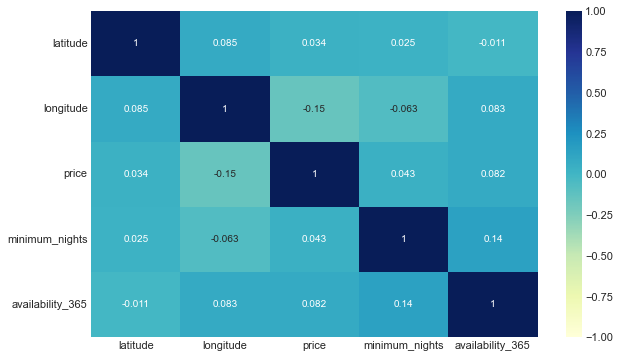

In [24]:
# Here we are ploting a correlation matrix see how all the variables correlate with each other .
correlation = df.corr()
plt.figure(figsize=(10, 6))
heatmap = sns.heatmap(correlation,linewidths=0, vmin=-1,annot=True, cmap="YlGnBu")

In [25]:
# see unique feature values
df.city.unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [26]:
# feature value counts - please use corresponding variables in your dataset
citydata = pd.DataFrame(df.city.value_counts())
citydata.reset_index(inplace=True)
citydata.rename(columns={'index':'city','city':'count'},inplace=True)
citydata

,city,count
0,Manhattan,21661
1,Brooklyn,20104
2,Queens,5666
3,Bronx,1091
4,Staten Island,373


In [27]:
# sort by value counts - no need for this dataset
#citydata.sort_values(by="count" , ascending=True, inplace=True)
#citydata

In [28]:
# barplot with label
x = citydata["city"].values
y = citydata["count"].values
fig = plt.figure(figsize=(10,8),dpi=1000)
plt.bar(x,y, label="Count By City", color="turquoise", alpha=0.8)
for a,b,i in zip(x,y,range(len(x))): # zip 函数
    plt.text(a,b+0.01,"%.2f"%y[i],ha='center',fontsize=12, rotation=0)
plt.ylabel('Count', fontsize=15)
plt.title('Airbnb Counts By City', fontweight="bold")
plt.xticks(rotation=45, fontsize=10)
plt.legend()
plt.show()

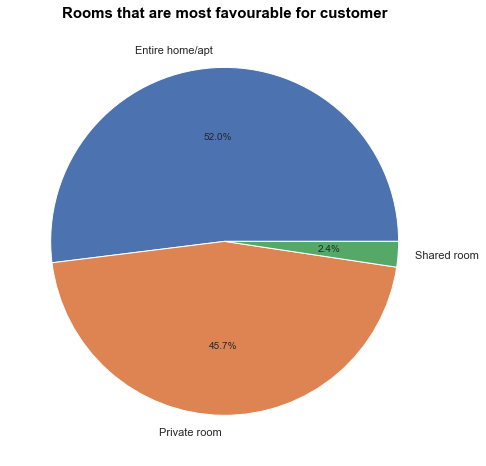

In [29]:
# pie plot
labels = df['room_type'].value_counts().index
sizes = df['room_type'].value_counts().values
plt.figure(figsize = (8,8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title("Rooms that are most favourable for customer", color = 'black',fontsize = 15, fontweight="bold");

#### data with longitudde, latitude - we can draw map

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

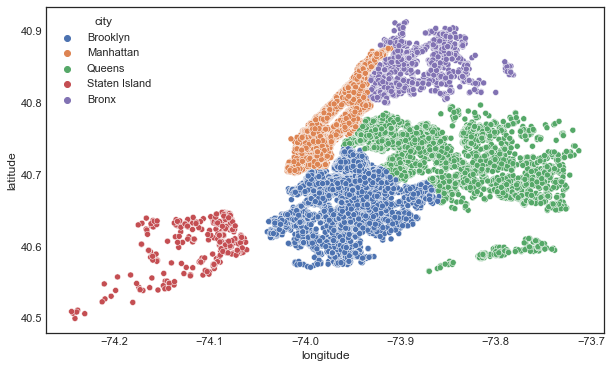

In [30]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df.longitude,y=df.latitude,hue=df.city)

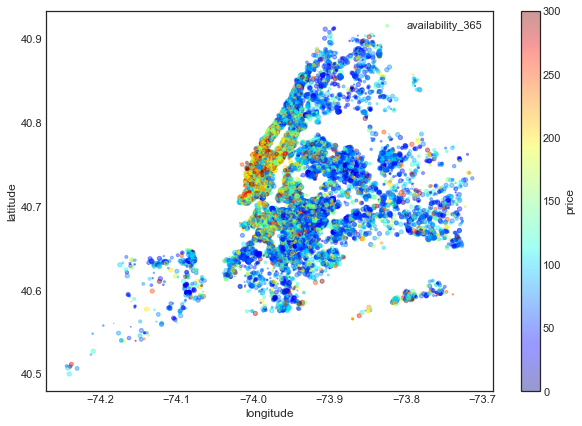

In [31]:
df_price_cap = df[df['price']<=300]

df_price_cap.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
    s=df_price_cap["availability_365"]/20, label="availability_365", figsize=(10,7),
    c="price", cmap=plt.get_cmap("jet"), colorbar=True,
    sharex=False)
plt.legend()

In [32]:
# check interactive object distribution on the map

import folium
from folium import plugins

# nyc latitude, longitude
latitude = 40.73
longitude = -73.94

# let's start again with a clean copy of the map of San Francisco
nyc_map = folium.Map(location = [latitude, longitude], zoom_start = 12)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(nyc_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng in zip(df.latitude, df.longitude):
    folium.Marker(
        location=[lat, lng],
        icon=None
    ).add_to(incidents)

# add incidents to map
nyc_map.add_child(incidents)

In [33]:
df.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room'], dtype=object)

In [34]:
roomdata = pd.DataFrame(df.room_type.value_counts())
roomdata.reset_index(inplace=True)
roomdata.rename(columns={'index':'room_type','room_type':'count'},inplace=True)
roomdata

,room_type,count
0,Entire home/apt,25409
1,Private room,22326
2,Shared room,1160


In [35]:
x = roomdata["room_type"].values
y = roomdata["count"].values
fig = plt.figure(figsize=(10,8),dpi=1000)
plt.bar(x,y, label="Count By Room Type",color="cadetblue", alpha=0.8)
for a,b,i in zip(x,y,range(len(x))): # zip 函数
    plt.text(a,b+0.01,"%.0f"%y[i],ha='center',fontsize=10, rotation=0)
plt.title('Count by Room Type', fontsize=10, weight="bold" )
plt.xticks(rotation=45, fontsize=10)
plt.legend()
plt.show()

In [36]:
city_room_type = df.groupby(['city'])['room_type'].value_counts().unstack(0)
print(city_room_type)

city             Bronx  Brooklyn  Manhattan  Queens  Staten Island
room_type                                                         
Entire home/apt    379      9559      13199    2096            176
Private room       652     10132       7982    3372            188
Shared room         60       413        480     198              9


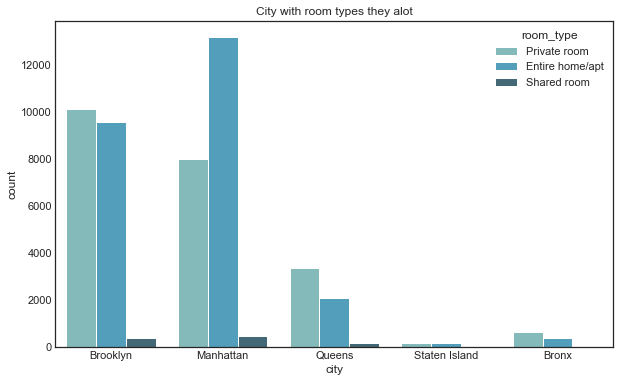

In [37]:
# show count by 2 features
plt.figure(figsize=(10,6))
sns.countplot(data=df,x='city',hue='room_type',palette='GnBu_d')
plt.title('City with room types they alot')
plt.show()

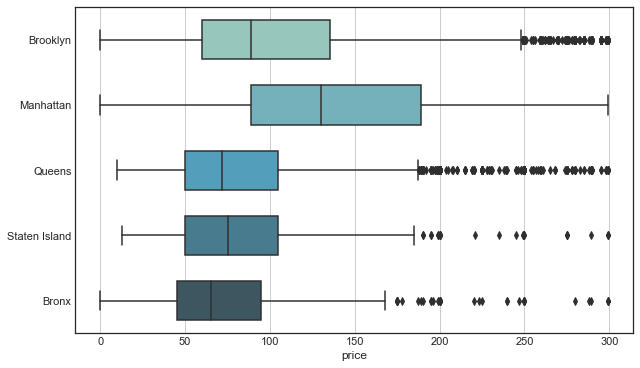

In [38]:
# box plot
f, ax = plt.subplots(figsize=(10, 6))
sns.boxplot(data=df[df['price']<300],y='city',x='price',width=.6,palette='GnBu_d')
ax.xaxis.grid(True)
ax.set(ylabel="");

In [39]:
# no severe outliers，use mean
ngroup = df.groupby('room_type', as_index=False)[['availability_365']].mean()
ngroup

,room_type,availability_365
0,Entire home/apt,111.920304
1,Private room,111.203933
2,Shared room,162.000862


In [40]:
# as_index should be FALSE
ngroup = df.groupby('room_type', as_index=True)[['availability_365']].mean()
ngroup

,availability_365
room_type,
Entire home/apt,111.920304
Private room,111.203933
Shared room,162.000862


[]

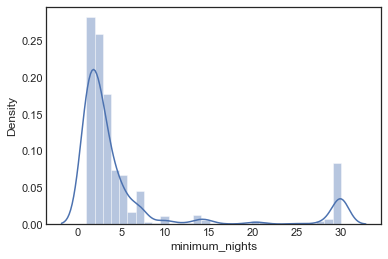

In [41]:
# density distribution
sns.distplot(df[(df['minimum_nights'] <= 30) & (df['minimum_nights'] > 0)]['minimum_nights'], bins=31)
plt.plot()

In [42]:
import folium
from folium.plugins import HeatMap

m=folium.Map([40.7128,-74.0060],zoom_start=11)
HeatMap(df[['latitude','longitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(m)
display(m)

In [43]:
df

,city,latitude,longitude,room_type,price,minimum_nights,availability_365
0,Brooklyn,40.64749,-73.97237,Private room,149,1,365
1,Manhattan,40.75362,-73.98377,Entire home/apt,225,1,355
2,Manhattan,40.80902,-73.94190,Private room,150,3,365
3,Brooklyn,40.68514,-73.95976,Entire home/apt,89,1,194
4,Manhattan,40.79851,-73.94399,Entire home/apt,80,10,0
...,...,...,...,...,...,...,...
48890,Brooklyn,40.67853,-73.94995,Private room,70,2,9
48891,Brooklyn,40.70184,-73.93317,Private room,40,4,36
48892,Manhattan,40.81475,-73.94867,Entire home/apt,115,10,27
48893,Manhattan,40.75751,-73.99112,Shared room,55,1,2


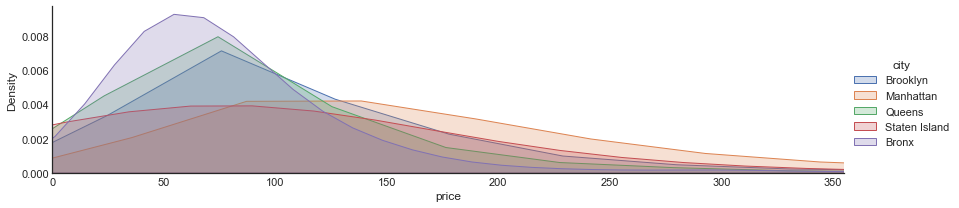

In [44]:
# see numeric feature distribution by another distribution
facet = sns.FacetGrid(df, hue="city",aspect=4)
facet.map(sns.kdeplot,'price',shade= True)
facet.set(xlim=(0, np.percentile(df['price'], 95)))
facet.add_legend() 
plt.show()